In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from statsmodels.api import Logit
from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report


plt.rcParams['font.family'] = 'NanumGothic'
matplotlib.rc("axes", unicode_minus = False)

# 실습1 
고객 이탈 여부 예측

In [2]:
# 데이터 불러오기
df_raw = pd.read_csv("통신고객이탈.csv")
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


CHURN	: 이탈여부(Active-유지,Churn-이탈)	목표변수 <br>
CUSTOMER_ID	 : 고객 ID<br>
GENDER	성별(F,M)	<br>
AGE	나이<br>
CHARGE_TYPE	요금제	<br>
HANDSET	기종	<br>
USAGE_BAND	사용 대역폭 : 범주형<br>
SERVICE_DURATION	사용기간 : 연속형<br>
DROPPED_CALLS	콜Drop 횟수<br>
PEAK_CALLS_NO	피크타임 통화 횟수	<br>
PEAK_CALLS_TIME	피크타임 통화 횟수	<br>
WEEKEND_CALLS_NO	주말 통화 수	<br>
WEEKEND_CALLS_TIME	주말 통화 시간	<br>
TOTAL_CALLS_NO	전체 통화 수	<br>
TOTAL_CALLS_TIME	전체 콜 시간	<br>

In [3]:
# 요금제 종류
df_raw["CHARGE_TYPE"].unique()

array(['CAT 100', 'CAT 200', 'Play 100', 'Play 300', 'CAT 50'],
      dtype=object)

In [4]:
# 기종 종류
df_raw["HANDSET"].unique()

array(['ASAD170', 'S50', 'S80', 'ASAD90', 'BS110', 'BS210', 'WC95',
       'CAS30', 'CAS60', 'SOP10', 'SOP20'], dtype=object)

In [5]:
# 사용 대역폭 종류
df_raw["USAGE_BAND"].unique()

array(['Med', 'MedHigh', 'High', 'MedLow', 'Low', 'None'], dtype=object)

In [6]:
df_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 930 entries, 0 to 929
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   CHURN               930 non-null    object 
 1   CUSTOMER_ID         930 non-null    object 
 2   GENDER              930 non-null    object 
 3   AGE                 930 non-null    int64  
 4   CHARGE_TYPE         930 non-null    object 
 5   HANDSET             930 non-null    object 
 6   USAGE_BAND          930 non-null    object 
 7   SERVICE_DURATION    930 non-null    float64
 8   DROPPED_CALLS       930 non-null    int64  
 9   PEAK_CALLS_NO       930 non-null    int64  
 10  PEAK_CALLS_TIME     930 non-null    float64
 11  WEEKEND_CALLS_NO    930 non-null    int64  
 12  WEEKEND_CALLS_TIME  930 non-null    float64
 13  TOTAL_CALLS_NO      930 non-null    int64  
 14  TOTAL_CALLS_TIME    930 non-null    float64
dtypes: float64(4), int64(5), object(6)
memory usage: 109.1+ K

In [7]:
df_raw["CHURN"].value_counts()

Active     750
Churned    180
Name: CHURN, dtype: int64

In [8]:
df_raw["USAGE_BAND"].value_counts()

Med        506
MedHigh    237
MedLow     107
High        63
Low         15
None         2
Name: USAGE_BAND, dtype: int64

In [9]:
df_raw[df_raw["USAGE_BAND"] == "None"]

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
269,Active,K243820,F,33,Play 100,BS110,None,25.5,2,0,0.0,0,0.0,0,0.0
821,Churned,K212470,M,12,Play 100,CAS30,None,36.9,2,0,0.0,0,0.0,0,0.0


In [10]:
df_raw.drop(df_raw[df_raw["USAGE_BAND"] == "None"].index , inplace = True)

In [11]:
df_raw["USAGE_BAND"].value_counts()

Med        506
MedHigh    237
MedLow     107
High        63
Low         15
Name: USAGE_BAND, dtype: int64

USAGE_BAND 변수에서 None값을 제거하였다.

In [12]:
# 결측치 확인

df_raw.isna().sum(axis = 0)

CHURN                 0
CUSTOMER_ID           0
GENDER                0
AGE                   0
CHARGE_TYPE           0
HANDSET               0
USAGE_BAND            0
SERVICE_DURATION      0
DROPPED_CALLS         0
PEAK_CALLS_NO         0
PEAK_CALLS_TIME       0
WEEKEND_CALLS_NO      0
WEEKEND_CALLS_TIME    0
TOTAL_CALLS_NO        0
TOTAL_CALLS_TIME      0
dtype: int64

결측치 존재하지 않는다.

## 데이터 전처리

In [13]:
# 이탈여부에 대한 라벨 인코딩

from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
df_raw['CHURN'] = label_encoder.fit_transform(df_raw['CHURN'])
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,0,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,0,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,0,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,0,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,0,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [14]:
# trian, test 데이터 분할

df_train , df_test = train_test_split(df_raw, test_size = 0.3, random_state = 1107)
print("train data size:", df_train.shape)
print()
print("test data size : ", df_test.shape)

train data size: (649, 15)

test data size :  (279, 15)


## 로지스틱 회귀모델 및 회귀계수 검토

고객아이디는 범주형이지만 고객의 고유 값이기에 모델링에서 제거하였다.

In [15]:
log_model = Logit.from_formula("""CHURN ~ C(GENDER) + AGE + C(CHARGE_TYPE) + C(HANDSET) + SERVICE_DURATION + DROPPED_CALLS + PEAK_CALLS_NO +
                   C(USAGE_BAND) +PEAK_CALLS_TIME + WEEKEND_CALLS_NO + WEEKEND_CALLS_TIME + TOTAL_CALLS_NO + TOTAL_CALLS_TIME""", df_train)
log_result = log_model.fit()
print(log_result.summary())

         Current function value: 0.264443
         Iterations: 35
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  649
Model:                          Logit   Df Residuals:                      620
Method:                           MLE   Df Model:                           28
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                  0.4807
Time:                        23:21:40   Log-Likelihood:                -171.62
converged:                      False   LL-Null:                       -330.50
Covariance Type:            nonrobust   LLR p-value:                 7.202e-51
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                    -28.8698   2.56e+04     -0.001      0.999   -5.03e+04    5.02e+04
C(GENDER)[T.M]   

/home/piai/anaconda3/lib/python3.10/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


GENDER , HANDSET , PEAK_CALLS_NO , WEEKEND_CALLS_NO , WEEKEND_CALLS_TIME , TOTAL_CALLS_NO , TOTAL_CALLS_TIME 변수의 p값이 0.05보다 작아서 제거하였다.

In [16]:
log_model = Logit.from_formula("""CHURN ~ AGE + C(CHARGE_TYPE) + SERVICE_DURATION + DROPPED_CALLS +
                   C(USAGE_BAND) +PEAK_CALLS_TIME""", df_train)
log_result = log_model.fit()
print(log_result.summary())

Optimization terminated successfully.
         Current function value: 0.450470
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  649
Model:                          Logit   Df Residuals:                      636
Method:                           MLE   Df Model:                           12
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                  0.1154
Time:                        23:21:40   Log-Likelihood:                -292.35
converged:                       True   LL-Null:                       -330.50
Covariance Type:            nonrobust   LLR p-value:                 2.095e-11
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                     -1.6979      1.066     -1.593      0.111      

## 예측 및 성능 평가

In [17]:
# 예측

y_pred_train = log_result.predict(df_train)
y_pred_train_class = (y_pred_train > 0.5).astype(int)  # 0.5 : “1/0” 판정 임계값(1 발생 확률) 변경 가능 
print("Train 예측 결과 \n", y_pred_train_class.head(), "\n")
print("Confusion Matrix: \n{}".format(confusion_matrix(df_train["CHURN"],y_pred_train_class)),"\n")

y_pred_test = log_result.predict(df_test)
y_pred_test_class = (y_pred_test > 0.5).astype(int)
print("Test 예측 결과 \n", y_pred_test_class.head(),"\n")
print("Confusion Matrix: \n{}".format(confusion_matrix(df_test["CHURN"],y_pred_test_class)),"\n")

Train 예측 결과 
 676    0
99     0
858    0
60     0
174    0
dtype: int64 

Confusion Matrix: 
[[502  13]
 [103  31]] 

Test 예측 결과 
 337    0
927    0
680    0
306    0
196    0
dtype: int64 

Confusion Matrix: 
[[227   7]
 [ 36   9]] 



In [18]:
# 평가

print("Train 예측/분류 결과")
print("Accuracy: {0:.3f}\n".format(accuracy_score(df_train["CHURN"], y_pred_train_class)))
print("Confusion Matrix: \n{}".format(confusion_matrix(df_train["CHURN"],y_pred_train_class)),"\n")
print(classification_report(df_train["CHURN"], y_pred_train_class, digits=3))

print("Test 예측/분류 결과")
print("Accuracy: {0:.3f}\n".format(accuracy_score(df_test["CHURN"], y_pred_test_class)))
print("Confusion Matrix: \n{}".format(confusion_matrix(df_test["CHURN"],y_pred_test_class)),"\n")
print(classification_report(df_test["CHURN"], y_pred_test_class, digits=3))

Train 예측/분류 결과
Accuracy: 0.821

Confusion Matrix: 
[[502  13]
 [103  31]] 

              precision    recall  f1-score   support

           0      0.830     0.975     0.896       515
           1      0.705     0.231     0.348       134

    accuracy                          0.821       649
   macro avg      0.767     0.603     0.622       649
weighted avg      0.804     0.821     0.783       649

Test 예측/분류 결과
Accuracy: 0.846

Confusion Matrix: 
[[227   7]
 [ 36   9]] 

              precision    recall  f1-score   support

           0      0.863     0.970     0.913       234
           1      0.562     0.200     0.295        45

    accuracy                          0.846       279
   macro avg      0.713     0.585     0.604       279
weighted avg      0.815     0.846     0.814       279



In [19]:

print("Train 예측/분류 결과")
print(classification_report(df_train["CHURN"], y_pred_train_class, target_names=['유지', '이탈'], digits=3))

print("Test 예측/분류 결과")
print(classification_report(df_test["CHURN"], y_pred_test_class, target_names=['유지', '이탈'], digits=3))

Train 예측/분류 결과
              precision    recall  f1-score   support

          유지      0.830     0.975     0.896       515
          이탈      0.705     0.231     0.348       134

    accuracy                          0.821       649
   macro avg      0.767     0.603     0.622       649
weighted avg      0.804     0.821     0.783       649

Test 예측/분류 결과
              precision    recall  f1-score   support

          유지      0.863     0.970     0.913       234
          이탈      0.562     0.200     0.295        45

    accuracy                          0.846       279
   macro avg      0.713     0.585     0.604       279
weighted avg      0.815     0.846     0.814       279



1에 대한 RECALL SCORE가 낮은것을 확인 할 수 있다.

## 결론 도출

<Axes: >

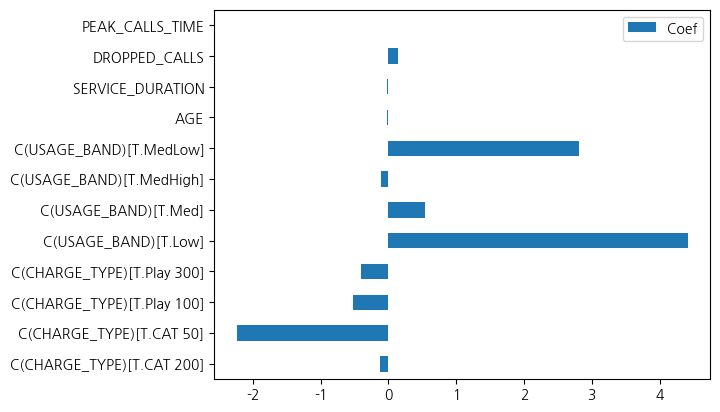

In [20]:
# 설명변수 중요도
df_logistic_coef = pd.DataFrame({"Coef": log_result.params.values[1:]}, index = log_model.exog_names[1:])
df_logistic_coef.plot.barh(y = "Coef")

사용 대역폭, 요금제 순으로 변수 중요도가 높다.
사용 대역폭이 낮을 수록 이탈할 가능성이 높아진다 <br>
요금제가 CAT 200이면 이탈할 가능성이 낮아진다

### 표준화 회귀 계수

In [21]:
# 데이터 불러오기
df_raw = pd.read_csv("통신고객이탈.csv")
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [22]:
# USAGE_BAND == none 인 값을 제거

df_raw.drop(df_raw[df_raw["USAGE_BAND"] == "None"].index , inplace = True)

In [23]:
# select_dtypes: 특정 변수 타입을 선택/제외하여 데이터 추출
df_char = df_raw.select_dtypes(include = "object")
df_numeric = df_raw.select_dtypes(exclude = "object")

# Data Scaling
scaler = StandardScaler()
np_numeric_scaled = scaler.fit_transform(df_numeric)
df_numeric_scaled = pd.DataFrame(np_numeric_scaled, columns = df_numeric.columns)

# 문자 데이터 + 숫자 데이터
df_scaled = pd.concat([df_numeric_scaled, df_char],axis = 1)
df_scaled.head()

,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,CHURN,CUSTOMER_ID,GENDER,CHARGE_TYPE,HANDSET,USAGE_BAND
0,-0.032072,-0.070373,0.947712,-0.034980,-0.620836,-0.434401,-0.758596,0.076104,-0.790430,Active,K102990,F,CAT 100,ASAD170,Med
1,-0.337329,-0.243718,2.089149,0.649679,-0.083668,-0.309595,-0.583032,0.256431,-0.463832,Active,K103280,M,CAT 100,S50,Med
2,-0.337329,1.062008,2.374509,0.150540,-0.228156,-0.996028,-1.351126,-0.328632,-0.824007,Active,K103660,M,CAT 100,ASAD170,Med
3,2.257358,1.005636,-0.479084,0.300724,-0.073181,-0.122385,1.433216,-0.084187,-0.402182,Active,K103730,M,CAT 100,ASAD170,Med
4,1.570529,1.529195,-0.764443,-0.021729,-0.279426,-0.559207,-0.665328,-0.292566,-0.715936,Active,K104560,F,CAT 100,S50,Med


In [24]:
# 이탈여부에 대한 라벨 인코딩

label_encoder = LabelEncoder()
df_scaled['CHURN'] = label_encoder.fit_transform(df_scaled['CHURN'])
df_scaled.head()

,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,CHURN,CUSTOMER_ID,GENDER,CHARGE_TYPE,HANDSET,USAGE_BAND
0,-0.032072,-0.070373,0.947712,-0.034980,-0.620836,-0.434401,-0.758596,0.076104,-0.790430,0,K102990,F,CAT 100,ASAD170,Med
1,-0.337329,-0.243718,2.089149,0.649679,-0.083668,-0.309595,-0.583032,0.256431,-0.463832,0,K103280,M,CAT 100,S50,Med
2,-0.337329,1.062008,2.374509,0.150540,-0.228156,-0.996028,-1.351126,-0.328632,-0.824007,0,K103660,M,CAT 100,ASAD170,Med
3,2.257358,1.005636,-0.479084,0.300724,-0.073181,-0.122385,1.433216,-0.084187,-0.402182,0,K103730,M,CAT 100,ASAD170,Med
4,1.570529,1.529195,-0.764443,-0.021729,-0.279426,-0.559207,-0.665328,-0.292566,-0.715936,0,K104560,F,CAT 100,S50,Med


In [25]:
# 데이터 분할
df_scaled_train, df_scaled_test = train_test_split(df_scaled, # 데이터
                               test_size = 0.3, # test 데이터의 비율
                               random_state = 10)  # random state

In [26]:
scaled_log_model = Logit.from_formula("""CHURN ~ AGE + C(CHARGE_TYPE) + SERVICE_DURATION + DROPPED_CALLS +
                   C(USAGE_BAND) +PEAK_CALLS_TIME""", df_scaled_train)
scaled_log_result = scaled_log_model.fit()
print(scaled_log_result.summary())

Optimization terminated successfully.
         Current function value: 0.437662
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                  CHURN   No. Observations:                  647
Model:                          Logit   Df Residuals:                      634
Method:                           MLE   Df Model:                           12
Date:                Thu, 07 Mar 2024   Pseudo R-squ.:                  0.1162
Time:                        23:21:40   Log-Likelihood:                -283.17
converged:                       True   LL-Null:                       -320.41
Covariance Type:            nonrobust   LLR p-value:                 4.615e-11
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                     -1.1974      0.500     -2.394      0.017      

<Axes: >

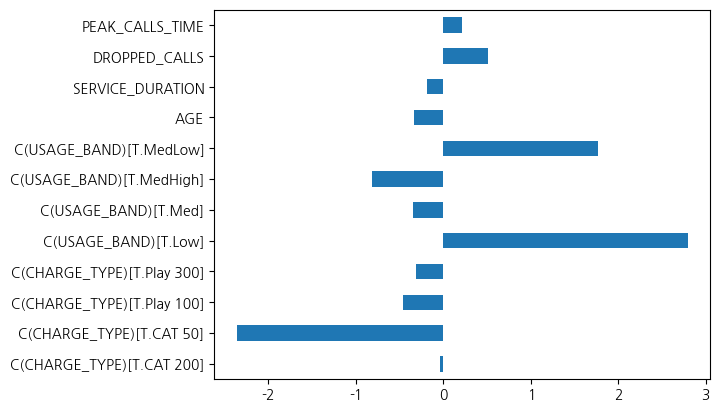

In [27]:
# 설명변수 중요도
df_log_scaled_coef = pd.DataFrame({"Coef": scaled_log_result.params.values[1:]}, index = scaled_log_model.exog_names[1:])
df_log_scaled_coef.plot.barh(y = "Coef", legend = False)

표준화 한 후에 모델링한 결과, 사용 대역폭, 요금제 순으로 변수 중요도가 높다.
사용 대역폭이 낮을 수록 이탈할 가능성이 높아진다 <br>
요금제가 CAT 50이면 이탈할 가능성이 낮아진다

# 실습2
의사결정나무 분류

In [28]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.tree import export_graphviz
import graphviz

from subprocess import call
from IPython.display import Image

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report

In [29]:
# 데이터 불러오기
df_raw = pd.read_csv("통신고객이탈.csv")
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [30]:
# USAGE_BAND == none 인 값을 제거

df_raw.drop(df_raw[df_raw["USAGE_BAND"] == "None"].index , inplace = True)
df_raw.drop("CUSTOMER_ID" , axis = 1, inplace = True)
df_raw

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
925,Churned,M,19,Play 100,SOP10,Med,17.40,12,60,100.8,27,59.4,127,628.2
926,Churned,F,59,Play 100,SOP20,Med,17.37,15,82,130.2,12,25.8,357,650.7
927,Churned,F,33,Play 300,S50,Med,44.93,12,174,286.2,25,67.0,596,1039.0
928,Churned,F,25,Play 300,S50,Med,40.43,14,315,552.0,0,0.0,609,1188.3


In [31]:
# 이탈여부에 대한 라벨 인코딩

label_encoder = LabelEncoder()
df_raw['CHURN'] = label_encoder.fit_transform(df_raw['CHURN'])
df_raw.head()

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,0,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,0,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,0,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,0,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,0,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [32]:
# get_dummies: 데이터의 문자형 변수에 대한 더미변수 생성 
df_raw_dummy = pd.get_dummies(df_raw)
df_raw_dummy.head()

,CHURN,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,...,HANDSET_S50,HANDSET_S80,HANDSET_SOP10,HANDSET_SOP20,HANDSET_WC95,USAGE_BAND_High,USAGE_BAND_Low,USAGE_BAND_Med,USAGE_BAND_MedHigh,USAGE_BAND_MedLow
0,0,31,33.33,6,218,379.8,9,21.6,366,632.4,...,0,0,0,0,0,0,0,1,0,0
1,0,27,30.87,10,373,656.4,11,28.0,411,810.4,...,1,0,0,0,0,0,0,1,0,0
2,0,27,49.40,11,260,582.0,0,0.0,265,614.1,...,0,0,0,0,0,0,0,1,0,0
3,0,61,48.60,1,294,661.8,14,101.5,326,844.0,...,0,0,0,0,0,0,0,1,0,0
4,0,52,56.03,0,221,555.6,7,25.0,274,673.0,...,1,0,0,0,0,0,0,1,0,0


In [33]:
# 데이터 분리:설명변수, 목표변수 구분
df_raw_x = df_raw_dummy.drop("CHURN", axis = 1, inplace = False)
df_raw_y = df_raw_dummy["CHURN"] 

# 데이터 분할 train_test_split(X: 설명변수, Y: 목표변수, test_size = test 데이터 비율)
df_train_x, df_test_x, df_train_y, df_test_y = train_test_split(
    df_raw_x, df_raw_y, test_size = 0.3, random_state = 10) 

print("분할 전 설명변수 데이터 :", df_raw_x.shape)
print("분할 후 설명변수 데이터 :Train", df_train_x.shape, "  Test",df_test_x.shape)

분할 전 설명변수 데이터 : (928, 32)
분할 후 설명변수 데이터 :Train (649, 32)   Test (279, 32)


In [34]:
from imblearn.over_sampling import SMOTE

# 목표변수 빈도 확인
print(df_raw.value_counts(["CHURN"]),"\n")
print("CHURN=1 비율  ", df_raw.value_counts(df_raw["CHURN"]==1)/len(df_raw))

CHURN
0        749
1        179
dtype: int64 

CHURN=1 비율   CHURN
False    0.807112
True     0.192888
dtype: float64


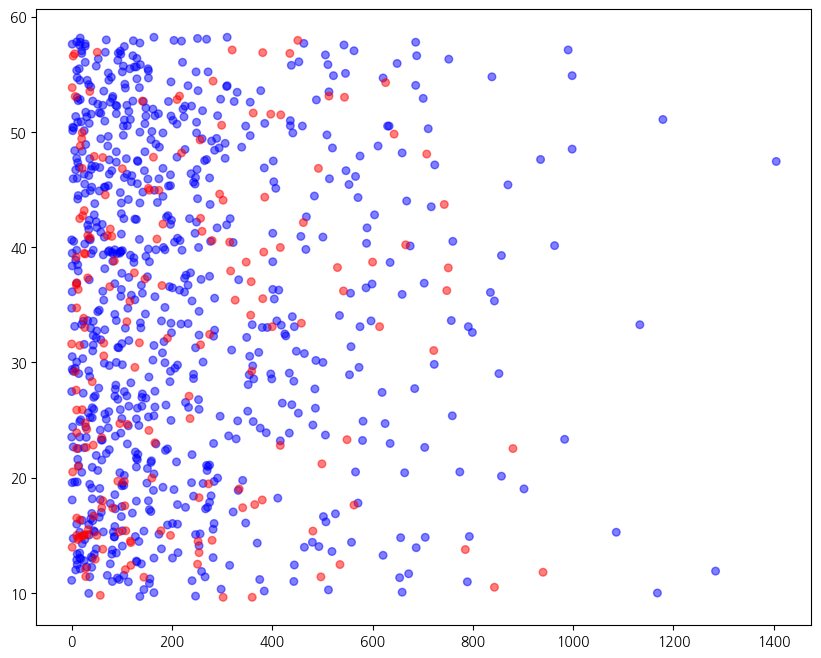

In [104]:
# 목표변수 산점도 확인
plt.figure(figsize=(10,8))
df_raw['color'] = np.where(df_raw["CHURN"]==1, "red", "blue")
plt.scatter(df_raw['PEAK_CALLS_NO'],df_raw['SERVICE_DURATION'],c=df_raw['color'], s=30, alpha=0.5)

plt.show()

In [35]:
# Over-sampling 
sm = SMOTE(sampling_strategy='auto', random_state=10)

x_resampled, y_resampled = sm.fit_resample(df_train_x,df_train_y)

print('Over-Sampling 전:\n',df_train_y.value_counts(),"\n")
print('Over-Sampling 후 Train X: {}'.format(x_resampled.shape))
print('Over-Sampling 후 Train Y: {} \n'.format(y_resampled.shape))

print("Over-Sampling 후 '1':{}".format(sum(y_resampled==1)))
print("Over-Sampling 후 '0':{}".format(sum(y_resampled==0)))

Over-Sampling 전:
 0    517
1    132
Name: CHURN, dtype: int64 

Over-Sampling 후 Train X: (1034, 32)
Over-Sampling 후 Train Y: (1034,) 

Over-Sampling 후 '1':517
Over-Sampling 후 '0':517


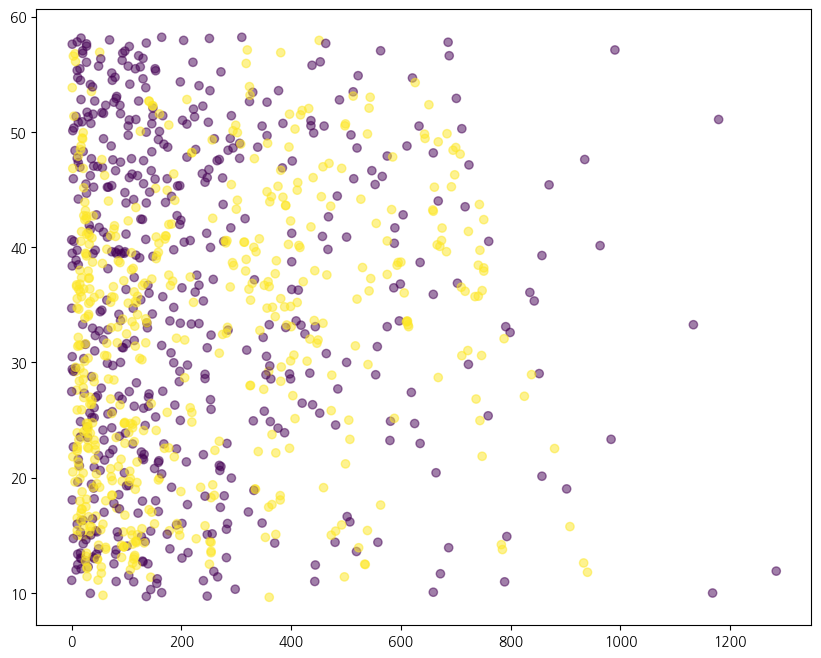

In [105]:
# 데이터 결합 및 산점도 확인
df_resampled = pd.concat([x_resampled,y_resampled], axis=1)

plt.figure(figsize=(10,8))
plt.scatter(df_resampled['PEAK_CALLS_NO'],df_resampled['SERVICE_DURATION'],
            c=df_resampled['CHURN'],alpha=0.5)
plt.show()

산점도를 확인해보면 DATA가 거리를 기반으로 OVERSAMPLING이 된 것을 확인할 수 있다.

## 모델생성
의사결정나무

In [36]:
tree_uncust = DecisionTreeClassifier(random_state=10 )
tree_uncust.fit(df_train_x, df_train_y)

# train 데이터 정확도
print("Accuracy on training set: {:.3f}".format(tree_uncust.score(df_train_x, df_train_y)))
# test 데이터 정확도
print("Accuracy on test set: {:.3f}".format(tree_uncust.score(df_test_x, df_test_y)))

Accuracy on training set: 1.000
Accuracy on test set: 0.857


In [37]:
# 파라미터 확인
print(tree_uncust.get_params().keys())
print(tree_uncust.get_params().values())

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'random_state', 'splitter'])
dict_values([0.0, None, 'gini', None, None, None, 0.0, 1, 2, 0.0, 10, 'best'])


In [38]:
# max_depth 최적값 설정

train_accuracy = []; test_accuracy = []

para_depth = [depth for depth in range(3, 12)]

for v_max_depth in para_depth:
    tree = DecisionTreeClassifier(max_depth = v_max_depth, random_state=10)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

df_accuracy_depth = pd.DataFrame()
df_accuracy_depth["Depth"] = para_depth
df_accuracy_depth["TrainAccuracy"] = train_accuracy
df_accuracy_depth["TestAccuracy"] = test_accuracy

para_depth

df_accuracy_depth.round(3)

,Depth,TrainAccuracy,TestAccuracy
0,3,0.900,0.885
1,4,0.908,0.882
2,5,0.932,0.871
3,6,0.937,0.878
4,7,0.948,0.878
5,8,0.958,0.878
6,9,0.969,0.871
7,10,0.972,0.864
8,11,0.980,0.875


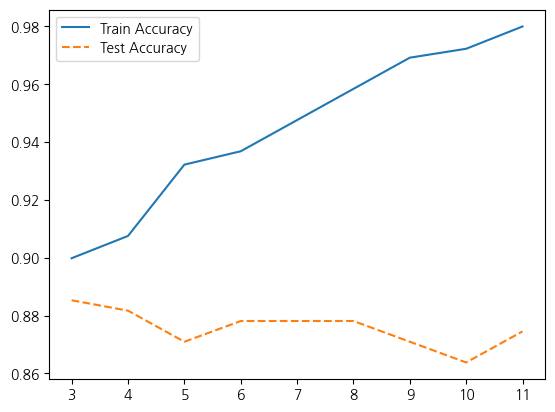

In [39]:
#그래프 확인
plt.plot(para_depth, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_depth, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

max_depth = 8 이상으로 넘어가면 test 정확도는 늘어나지 않는다. <br>
따라서 처음 제일 큰값 3과 8을 비교하겠다.

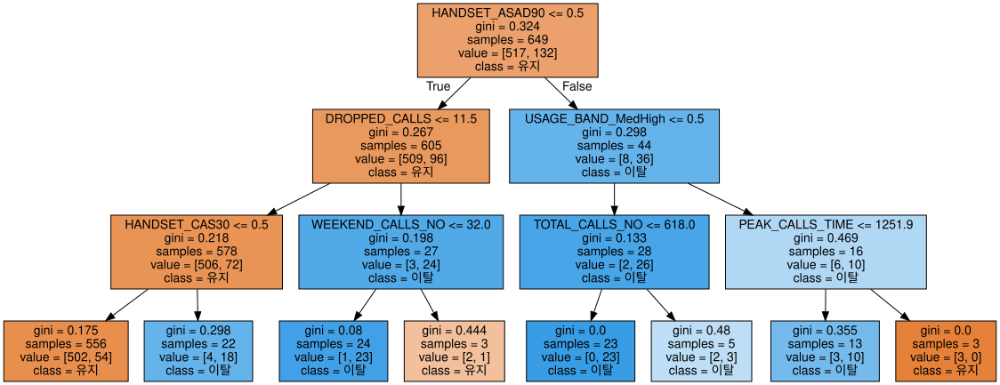

In [40]:
#max_depth 5일 때

v_feature_name = df_train_x.columns

tree_low = DecisionTreeClassifier(max_depth = 3, random_state=10)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file="tree_low.dot", class_names = ["유지", "이탈"], 
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

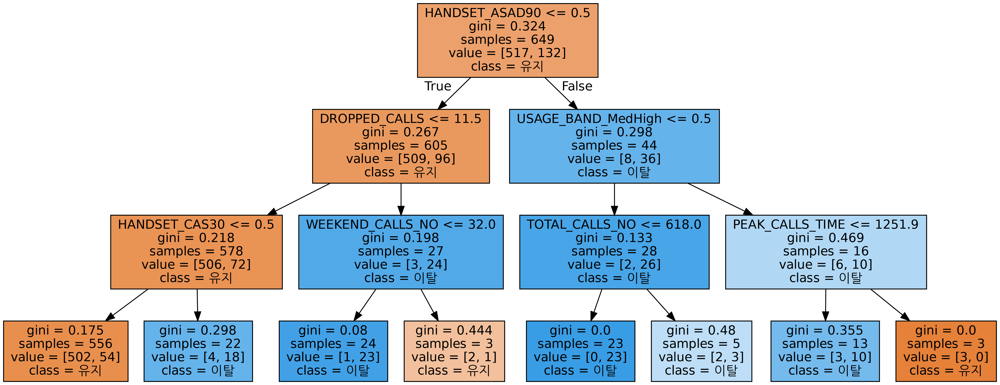

In [41]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

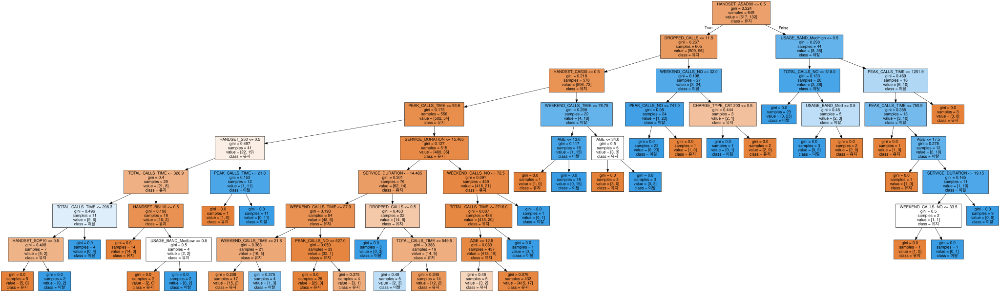

In [42]:
#max_depth 8일 때

v_feature_name = df_train_x.columns

tree_low = DecisionTreeClassifier(max_depth = 8, random_state=10)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file="tree_high.dot", class_names = ["유지", "이탈"], 
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_high.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [43]:
call(['dot', '-Tpng', 'tree_high.dot', '-o', 'tree_high.png', '-Gdpi=600'])
Image(filename = 'tree_high.png')

max_depth 8일때 성능이 더 좋아서 8로 선정

### min_samples_split 최적값 설정


In [44]:
print("전체 자료 = ", df_train_x.shape[0],"개")
print("전체 자료의 1% = ", df_train_x.shape[0] * 0.01,"개")

전체 자료 =  649 개
전체 자료의 1% =  6.49 개


In [45]:
# min_samples_split 최적값 설정

train_accuracy = []; test_accuracy = []
para_split = [n_split * 5 for n_split in range(2, 16)]

for v_min_samples_split in para_split:
    tree = DecisionTreeClassifier(min_samples_split = v_min_samples_split, max_depth=8, random_state=10)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

df_accuracy_split = pd.DataFrame()
df_accuracy_split["MinSamplesSplit"] = para_split
df_accuracy_split["TrainAccuracy"] = train_accuracy
df_accuracy_split["TestAccuracy"] = test_accuracy

df_accuracy_split.round(3)

,MinSamplesSplit,TrainAccuracy,TestAccuracy
0,10,0.941,0.871
1,15,0.932,0.892
2,20,0.924,0.892
3,25,0.915,0.892
4,30,0.912,0.885
5,35,0.912,0.885
6,40,0.912,0.885
7,45,0.897,0.885
8,50,0.897,0.885
9,55,0.897,0.885


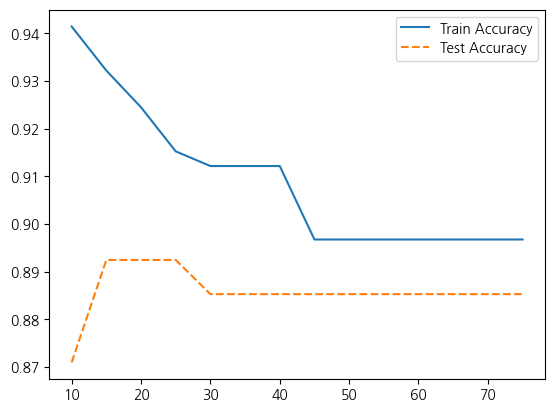

In [46]:

plt.plot(para_split, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_split, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

▶ min_samples_split = 20일때 test 정확도가 가장 높아서 25로 선정하였다.

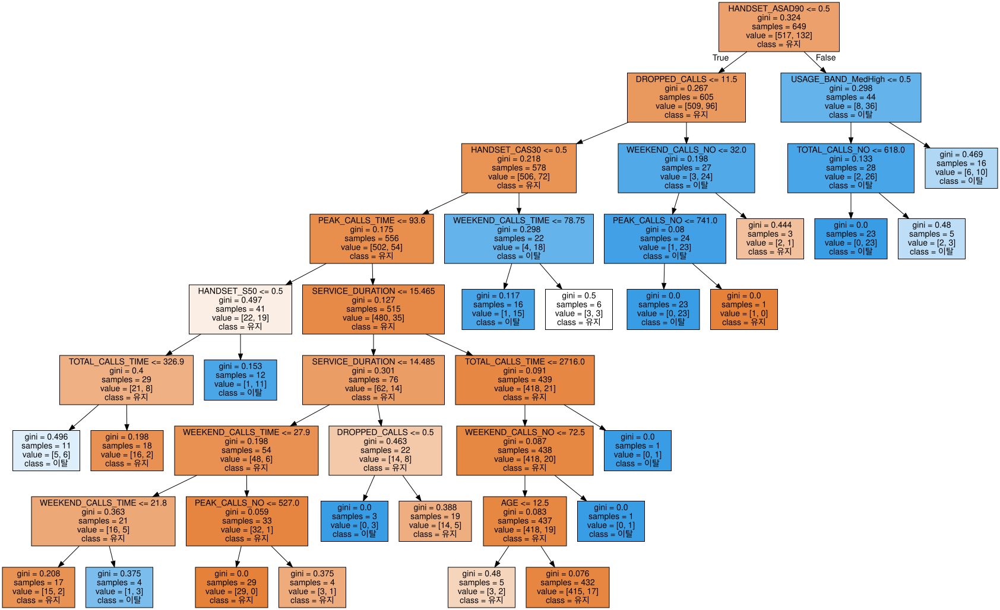

In [47]:
#  min_samples_split = 20 모델
tree_low = DecisionTreeClassifier(max_depth=8, min_samples_split=20, random_state=10)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file="tree_low.dot", class_names = ["유지", "이탈"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [48]:
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
Image(filename = 'tree_low.png')

### min_samples_leaf 최적해 설정

In [49]:
train_accuracy = []; test_accuracy = []
 
para_leaf = [n_leaf * 2 for n_leaf in range(5,16)]

for v_min_samples_leaf in para_leaf:
    tree = DecisionTreeClassifier(min_samples_leaf = v_min_samples_leaf, min_samples_split=20,
                                  max_depth=8, random_state=10)
    tree.fit(df_train_x, df_train_y)
    train_accuracy.append(tree.score(df_train_x, df_train_y))
    test_accuracy.append(tree.score(df_test_x, df_test_y))

df_accuracy_leaf = pd.DataFrame()
df_accuracy_leaf["MinSamplesLeaf"] = para_leaf
df_accuracy_leaf["TrainAccuracy"] = train_accuracy
df_accuracy_leaf["TestAccuracy"] = test_accuracy

df_accuracy_leaf.round(3)

,MinSamplesLeaf,TrainAccuracy,TestAccuracy
0,10,0.911,0.903
1,12,0.909,0.892
2,14,0.908,0.885
3,16,0.908,0.885
4,18,0.904,0.903
5,20,0.903,0.907
6,22,0.894,0.892
7,24,0.889,0.885
8,26,0.889,0.885
9,28,0.855,0.857


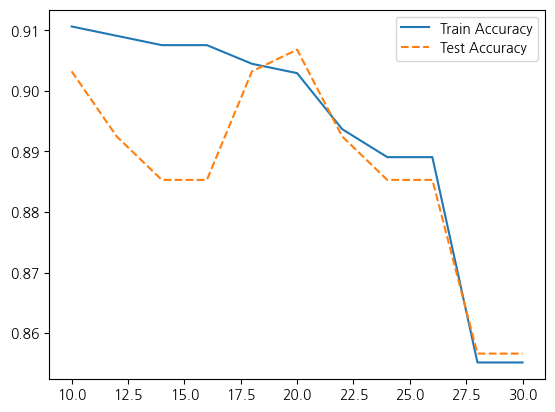

In [50]:

plt.plot(para_leaf, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_leaf, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.legend()

min_samples_leaf = 20 일때 test 정확도가 가장 높아서 20으로 선정하였다.

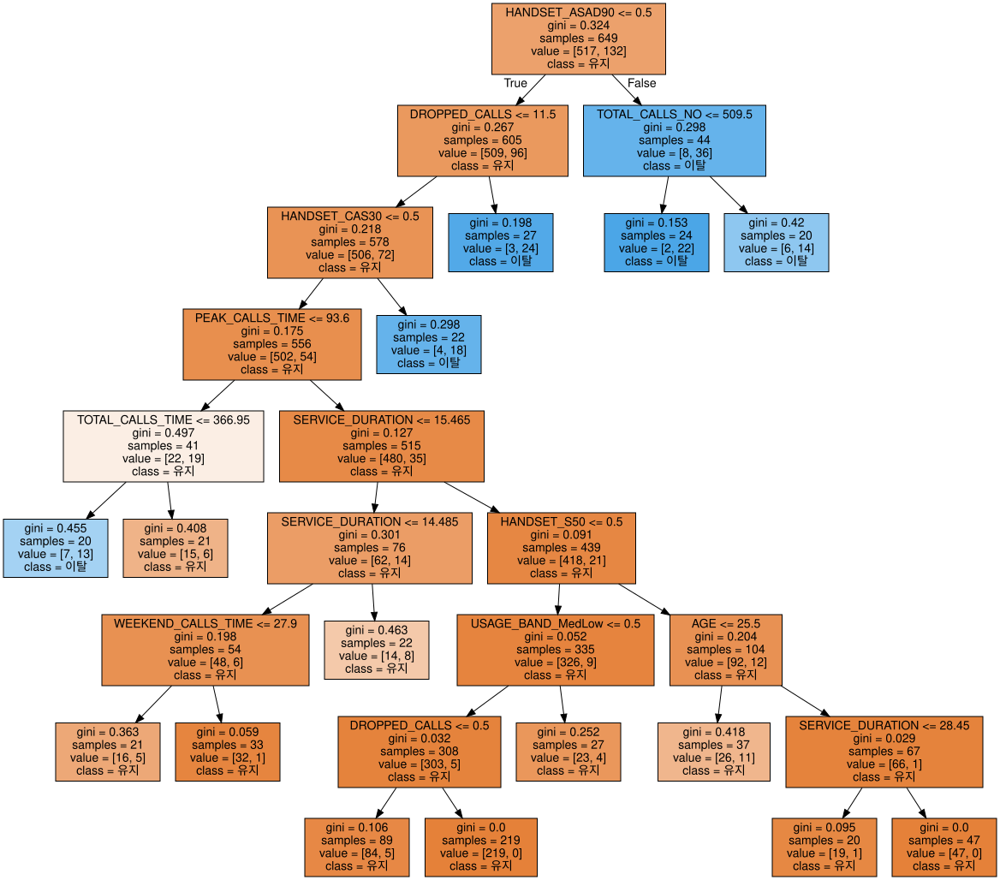

In [51]:
# min_samples_leaf = 20 모델
tree_low = DecisionTreeClassifier(max_depth=8, min_samples_split=20, min_samples_leaf=20, random_state=10)
tree_low.fit(df_train_x, df_train_y)

export_graphviz(tree_low, out_file=" tree_low.dot", class_names = ["유지", "이탈"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open(" tree_low.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [52]:
# 생성된 .dot 파일을 .png로 변환
call(['dot', '-Tpng', 'tree_low.dot', '-o', 'tree_low.png', '-Gdpi=600'])
# jupyter notebook에서 작업디렉토리에 있는 .png 직접 출력
Image(filename = 'tree_low.png')

# 최종 모델

In [53]:
tree_final = DecisionTreeClassifier(max_depth=8, min_samples_split=20, min_samples_leaf=20, random_state=10)
tree_final.fit(df_train_x, df_train_y)

DecisionTreeClassifier(max_depth=8, min_samples_leaf=20, min_samples_split=20,
                       random_state=10)

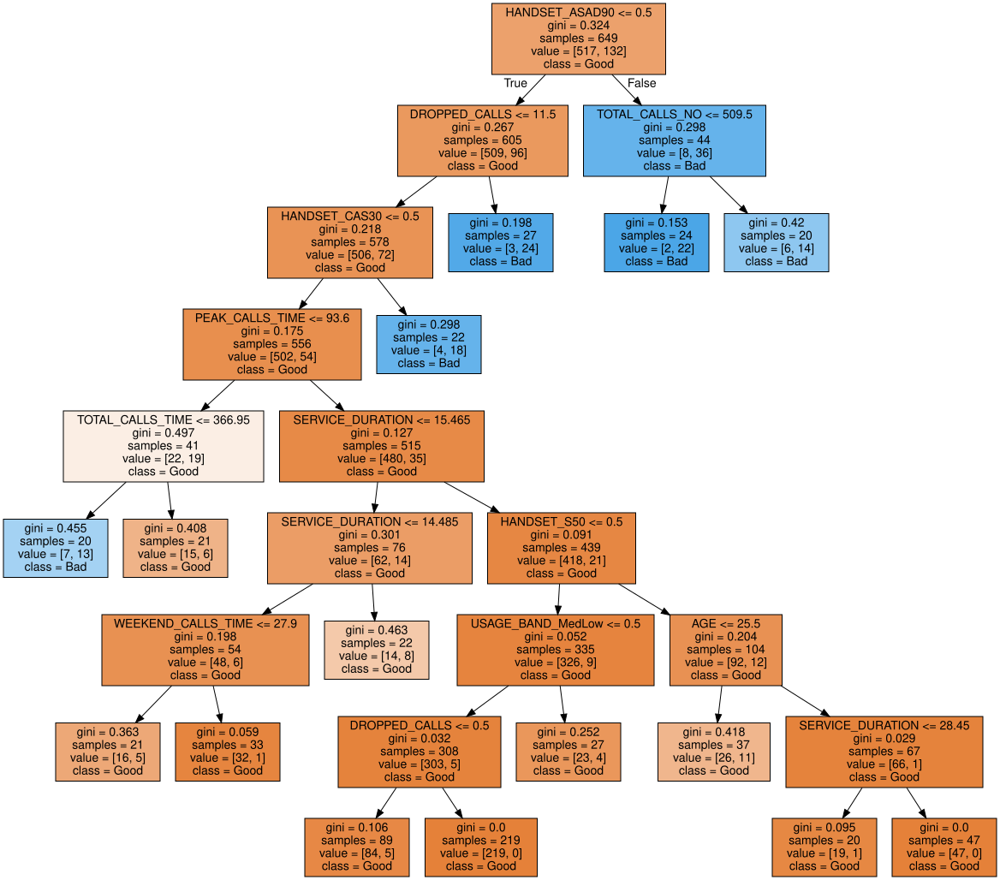

In [54]:
export_graphviz(tree_final, out_file="tree_final.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [55]:
call(['dot', '-Tpng', 'tree_final.dot', '-o', 'tree_final.png', '-Gdpi=600'])
Image(filename = 'tree_final.png')

In [56]:
y_pred = tree_final.predict(df_test_x)
print("Test Accuracy: {0:.3f}\n".format(tree_final.score(df_test_x, df_test_y)))
print("Test Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))

print(classification_report(df_test_y, y_pred, digits=3))

Test Accuracy: 0.907

Test Confusion matrix: 
[[225   7]
 [ 19  28]]
              precision    recall  f1-score   support

           0      0.922     0.970     0.945       232
           1      0.800     0.596     0.683        47

    accuracy                          0.907       279
   macro avg      0.861     0.783     0.814       279
weighted avg      0.902     0.907     0.901       279



1의 recall score 가 낮은것을 확인할 수 있다.

### 설명변수 중요도

In [57]:
# tree.feature_importances_로 설명변수 중요도 확인 및 테이블로 저장
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final.feature_importances_

# df_feature_importance의 테이블을 중요도별로 정렬
df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
17,HANDSET_ASAD90,0.309
2,DROPPED_CALLS,0.265
20,HANDSET_CAS30,0.191
4,PEAK_CALLS_TIME,0.103
1,SERVICE_DURATION,0.039
0,AGE,0.033
8,TOTAL_CALLS_TIME,0.024
22,HANDSET_S50,0.011
6,WEEKEND_CALLS_TIME,0.010
7,TOTAL_CALLS_NO,0.009


Text(0, 0.5, '설명변수')

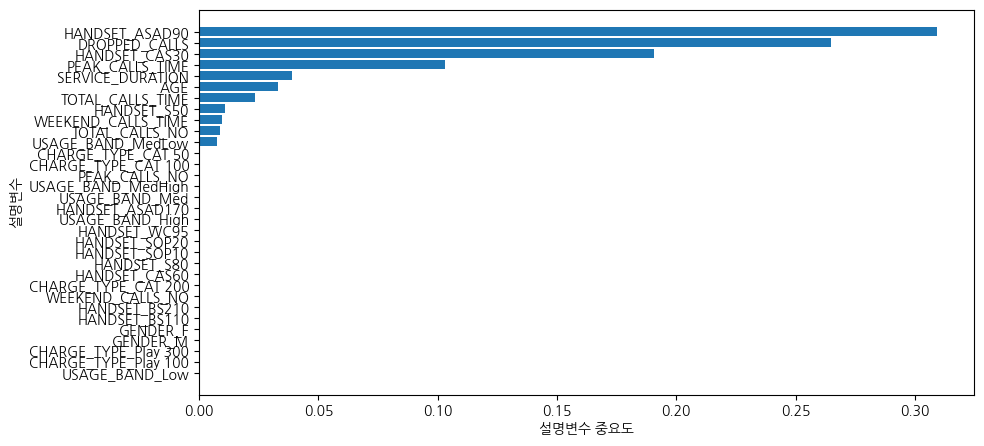

In [58]:
# 설명변수 중요도 그래프
# sort_values : 중요도가 높은 변수를 상위에 그림. 
df_importance.sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance))

plt.figure(figsize=(10,5))
plt.barh(y = coordinates, width = df_importance["Importance"])
plt.yticks(coordinates, df_importance["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

HANDSET_ASAD90 , DROPPED_CALLS , HANDSET_CAS30 , PEAK_CALLS_TIME 순으로 중요하다.<br>
즉 기종 , 콜drop횟수 , 피크타임 통화 시간에 따라 이탈율이 달라진다. <br>
따라서 이탈 고객을 잡기 위해서는 새로운 기종을 싸게 주는 전략이 필요할것 같다.

## Over-sampling Data이용한 모델링 및 평가

In [59]:
df_train_x_over, df_test_x_over, df_train_y_over, df_test_y_over = train_test_split(
    x_resampled, y_resampled, test_size = 0.3, stratify=y_resampled, random_state = 10) 

print("분할 전 데이터 현황... 설명:", x_resampled.shape, "  목표:", y_resampled.shape)
print("분할 후 설명변수 현황...Train:", df_train_x_over.shape, " Test:", df_test_x_over.shape)
print("분할 후 목표변수 현황...Train:", df_train_y_over.value_counts(), " Test:", df_test_y_over.value_counts())

분할 전 데이터 현황... 설명: (1034, 32)   목표: (1034,)
분할 후 설명변수 현황...Train: (723, 32)  Test: (311, 32)
분할 후 목표변수 현황...Train: 0    362
1    361
Name: CHURN, dtype: int64  Test: 1    156
0    155
Name: CHURN, dtype: int64


In [60]:
# 최종 모델의 hyper-parameter 이용: 원칙은 하이퍼 파라미터 튜닝 필요
tree_final_over = DecisionTreeClassifier(max_depth=8, min_samples_split=20, min_samples_leaf=20, random_state=10)

tree_final_over.fit(df_train_x_over, df_train_y_over)

DecisionTreeClassifier(max_depth=8, min_samples_leaf=20, min_samples_split=20,
                       random_state=10)

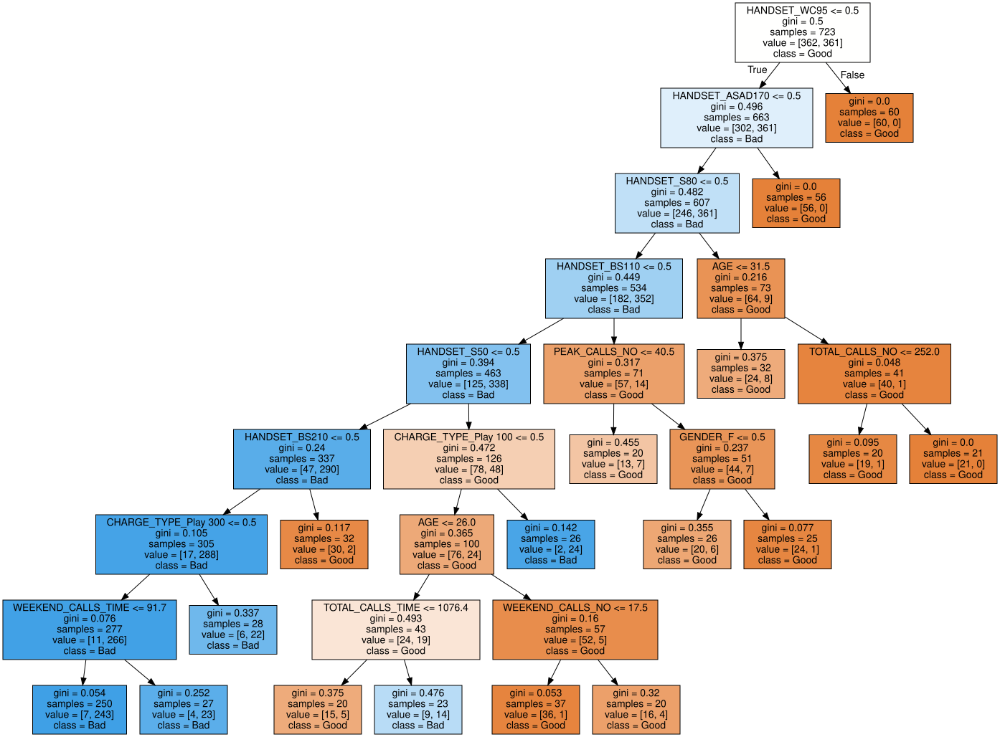

In [61]:
export_graphviz(tree_final_over, out_file="tree_final_over.dot", class_names = ["Good", "Bad"],
                feature_names = v_feature_name, impurity = True, filled = True)

with open("tree_final_over.dot") as f:
    dot_graph = f.read()
display(graphviz.Source(dot_graph))

In [62]:
call(['dot', '-Tpng', 'tree_final_over.dot', '-o', 'tree_final_over.png', '-Gdpi=600'])

Image(filename = 'tree_final_over.png')

### 오버샘플링 모델의 평가

In [63]:
# 평가
y_pred_over = tree_final_over.predict(df_test_x_over)
print("Test Accuracy: {0:.3f}\n".format(tree_final_over.score(df_test_x_over, df_test_y_over)))
print("Test Confusion matrix: \n{}".format(confusion_matrix(df_test_y_over, y_pred_over)))

# 목표변수의 빈도 불균형 : f1 score로 모델 평가 
print(classification_report(df_test_y_over, y_pred_over, digits=3))

Test Accuracy: 0.923

Test Confusion matrix: 
[[144  11]
 [ 13 143]]
              precision    recall  f1-score   support

           0      0.917     0.929     0.923       155
           1      0.929     0.917     0.923       156

    accuracy                          0.923       311
   macro avg      0.923     0.923     0.923       311
weighted avg      0.923     0.923     0.923       311



오버 샘플링 하기전과 후를 비교했을 때 1의 recall score가 향상된 것을 확인할 수 있다.

-- 변수 중요도 확인 --

In [64]:
df_importance = pd.DataFrame()
df_importance["Feature"] = v_feature_name
df_importance["Importance"] = tree_final_over.feature_importances_

df_importance.sort_values("Importance", ascending=False, inplace = True)
df_importance.round(3)

,Feature,Importance
19,HANDSET_BS210,0.171
22,HANDSET_S50,0.160
23,HANDSET_S80,0.140
16,HANDSET_ASAD170,0.138
18,HANDSET_BS110,0.133
26,HANDSET_WC95,0.124
14,CHARGE_TYPE_Play 100,0.073
0,AGE,0.030
8,TOTAL_CALLS_TIME,0.010
15,CHARGE_TYPE_Play 300,0.006


Text(0, 0.5, '설명변수')

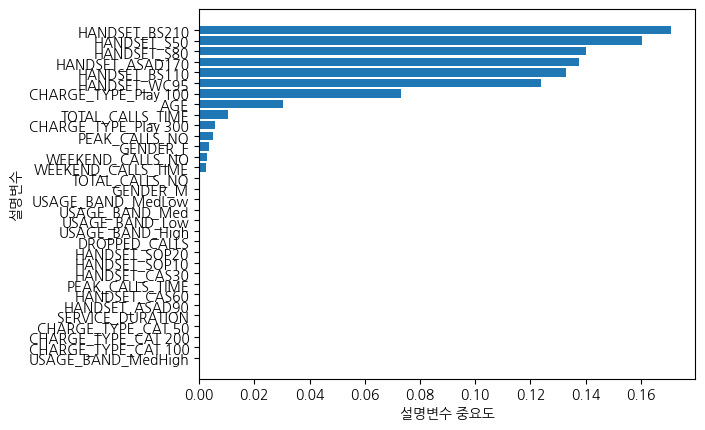

In [65]:
# 설명변수 중요도 그래프
# sort_values : 중요도가 높은 변수를 상위에 그림. 
df_importance.sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance))
plt.barh(y = coordinates, width = df_importance["Importance"])
plt.yticks(coordinates, df_importance["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

-- Over-sampling Data이용한 모델링 및 평가 -- 

##### @해석 : 기종과 요금제 나이순으로 중요도가 높았다.

이탈하는 고객을 잡기 위해서는 새로운 기종에 대한 할인을 해주는 전력 or <br>
요금제를 더 좋은 혜택으로 제공해주는 전략등 다양한 전략을 생각해볼 수 있다.

# 실습 3
앙상블 - 랜덤 포레스트

In [66]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, f1_score 
from sklearn.metrics import confusion_matrix, classification_report

matplotlib.rc("axes", unicode_minus = False)

In [67]:
# 데이터 불러오기
df_raw = pd.read_csv("통신고객이탈.csv")
df_raw.head()

,CHURN,CUSTOMER_ID,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,K102990,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,K103280,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,K103660,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,K103730,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,K104560,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [68]:
# USAGE_BAND == none 인 값을 제거
# CUSTOMER_ID 변수 제거

df_raw.drop(df_raw[df_raw["USAGE_BAND"] == "None"].index , inplace = True)
df_raw.drop("CUSTOMER_ID" , axis = 1, inplace = True)
df_raw

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,Active,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,Active,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,Active,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,Active,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,Active,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
925,Churned,M,19,Play 100,SOP10,Med,17.40,12,60,100.8,27,59.4,127,628.2
926,Churned,F,59,Play 100,SOP20,Med,17.37,15,82,130.2,12,25.8,357,650.7
927,Churned,F,33,Play 300,S50,Med,44.93,12,174,286.2,25,67.0,596,1039.0
928,Churned,F,25,Play 300,S50,Med,40.43,14,315,552.0,0,0.0,609,1188.3


In [69]:
# 이탈여부에 대한 라벨 인코딩

label_encoder = LabelEncoder()
df_raw['CHURN'] = label_encoder.fit_transform(df_raw['CHURN'])
df_raw.head()

,CHURN,GENDER,AGE,CHARGE_TYPE,HANDSET,USAGE_BAND,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME
0,0,F,31,CAT 100,ASAD170,Med,33.33,6,218,379.8,9,21.6,366,632.4
1,0,M,27,CAT 100,S50,Med,30.87,10,373,656.4,11,28.0,411,810.4
2,0,M,27,CAT 100,ASAD170,Med,49.40,11,260,582.0,0,0.0,265,614.1
3,0,M,61,CAT 100,ASAD170,Med,48.60,1,294,661.8,14,101.5,326,844.0
4,0,F,52,CAT 100,S50,Med,56.03,0,221,555.6,7,25.0,274,673.0


In [70]:
# 데이터의 문자형 변수에 대한 더미변수 생성 
df_raw_dummy = pd.get_dummies(df_raw)
df_raw_dummy.head()

,CHURN,AGE,SERVICE_DURATION,DROPPED_CALLS,PEAK_CALLS_NO,PEAK_CALLS_TIME,WEEKEND_CALLS_NO,WEEKEND_CALLS_TIME,TOTAL_CALLS_NO,TOTAL_CALLS_TIME,...,HANDSET_S50,HANDSET_S80,HANDSET_SOP10,HANDSET_SOP20,HANDSET_WC95,USAGE_BAND_High,USAGE_BAND_Low,USAGE_BAND_Med,USAGE_BAND_MedHigh,USAGE_BAND_MedLow
0,0,31,33.33,6,218,379.8,9,21.6,366,632.4,...,0,0,0,0,0,0,0,1,0,0
1,0,27,30.87,10,373,656.4,11,28.0,411,810.4,...,1,0,0,0,0,0,0,1,0,0
2,0,27,49.40,11,260,582.0,0,0.0,265,614.1,...,0,0,0,0,0,0,0,1,0,0
3,0,61,48.60,1,294,661.8,14,101.5,326,844.0,...,0,0,0,0,0,0,0,1,0,0
4,0,52,56.03,0,221,555.6,7,25.0,274,673.0,...,1,0,0,0,0,0,0,1,0,0


#### 데이터 분리/분할

In [79]:
df_raw_x = df_raw_dummy.drop("CHURN", axis = 1, inplace = False)
df_raw_y = df_raw_dummy["CHURN"] 


df_train_x, df_test_x, df_train_y, df_test_y = train_test_split(df_raw_x, # 설명변수 데이터
                                                                df_raw_y, # 목표변수 데이터
                                                                test_size = 0.3, # test 데이터의 비율
                                                                random_state = 10)  # random state

print("분할 전 설명변수 데이터 :", df_raw_x.shape)
print("분할 후 설명변수 데이터 :Train", df_train_x.shape, "  Test",df_test_x.shape)

분할 전 설명변수 데이터 : (928, 32)
분할 후 설명변수 데이터 :Train (649, 32)   Test (279, 32)


### 모델 생성
#### 랜덤 포레스트

In [80]:

rf_uncust = RandomForestClassifier(random_state=10)
rf_uncust.fit(df_train_x, df_train_y)

print("Accuracy on training set: {:.3f}".format(rf_uncust.score(df_train_x, df_train_y)))
print("Accuracy on test set: {:.3f}".format(rf_uncust.score(df_test_x, df_test_y)))

Accuracy on training set: 1.000
Accuracy on test set: 0.900


In [81]:
train_accuracy = []; test_accuracy = []
para_n_tree = [n_tree * 10 for n_tree in range(1, 16)]

for v_n_estimators in para_n_tree:
    rf = RandomForestClassifier(n_estimators = v_n_estimators, random_state = 10)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))

df_accuracy_n = pd.DataFrame()
df_accuracy_n["n_estimators"] = para_n_tree
df_accuracy_n["TrainAccuracy"] = train_accuracy
df_accuracy_n["TestAccuracy"] = test_accuracy

df_accuracy_n.round(3)

,n_estimators,TrainAccuracy,TestAccuracy
0,10,0.986,0.871
1,20,0.995,0.892
2,30,1.000,0.896
3,40,1.000,0.892
4,50,1.000,0.892
5,60,1.000,0.892
6,70,1.000,0.896
7,80,1.000,0.896
8,90,1.000,0.900
9,100,1.000,0.900


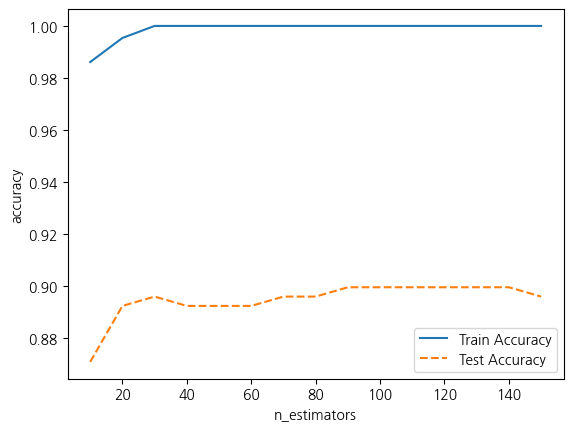

In [82]:
plt.plot(para_n_tree, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_n_tree, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("n_estimators"); plt.ylabel("accuracy")
plt.legend()

트리수가 90개 일때 test 정확도가 가장 높으므로 90개로 선정하였다.

#### n_estimators: 트리의 개수 변경 시 모델의 oob error 변화

In [83]:

oob_error = []

for v_n_estimator in range(5, 121):
    rf = RandomForestClassifier(n_estimators = v_n_estimator, oob_score = True, random_state= 1234)
    rf.fit(df_train_x, df_train_y)
    oob_error.append(1 - rf.oob_score_)

/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs do not have OOB scores. This probably means too few trees were used to compute any reliable OOB estimates.
  warn(
/home/piai/anaconda3/lib/python3.10/site-packages/sklearn/ensemble/_forest.py:583: UserWarning: Some inputs 

Text(0.5, 0, 'n_estimators')

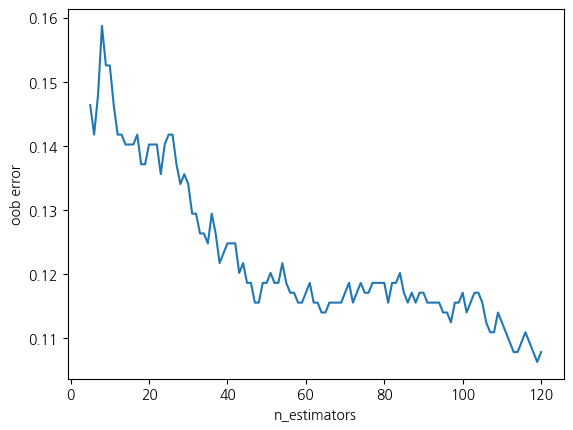

In [84]:
# 그래프로 표현
plt.plot(range(5, 121), oob_error)
plt.ylabel("oob error")
plt.xlabel("n_estimators")

트리수가 증가할 수록 error는 감소하는 것을 볼 수 있다. 다만 계속 증가하면 과적합이 될 수 있다.

In [92]:
# max_depth 최적값 설정


train_accuracy = []; test_accuracy = []
para_depth = [depth for depth in range(3, 11)]

for v_max_depth in para_depth:
    rf = RandomForestClassifier(max_depth = v_max_depth, n_estimators=90, random_state=10)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))

# 데이터 테이블로 저장
df_accuracy_depth = pd.DataFrame()
df_accuracy_depth["Depth"] = para_depth
df_accuracy_depth["TrainAccuracy"] = train_accuracy
df_accuracy_depth["TestAccuracy"] = test_accuracy


df_accuracy_depth.round(3)

,Depth,TrainAccuracy,TestAccuracy
0,3,0.820,0.842
1,4,0.878,0.871
2,5,0.917,0.889
3,6,0.931,0.892
4,7,0.940,0.878
5,8,0.949,0.889
6,9,0.952,0.900
7,10,0.961,0.892


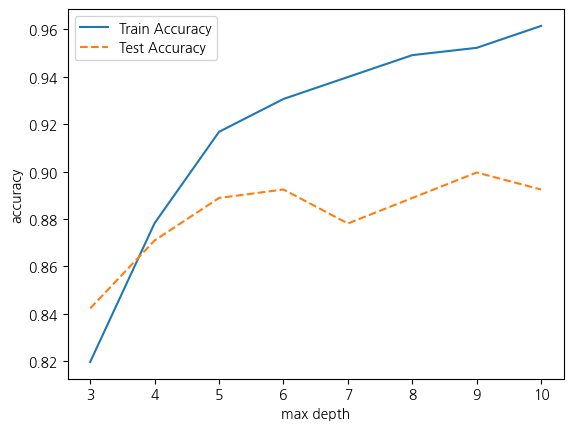

In [93]:

plt.plot(para_depth, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_depth, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("max depth"); plt.ylabel("accuracy")
plt.legend()

max_depth = 6일때 높았다가 다시 낮아졌다. 따라서 6으로 선정하였다.


In [94]:
# min_samples_split 최적값 설정

train_accuracy = []; test_accuracy = []
para_split = [n_split * 10 for n_split in range(1, 11)]

for v_min_samples_split in para_split:
    rf = RandomForestClassifier(min_samples_split = v_min_samples_split, max_depth=6,
                                n_estimators=90, random_state=10)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))

df_accuracy_split = pd.DataFrame()
df_accuracy_split["MinSamplesSplit"] = para_split
df_accuracy_split["TrainAccuracy"] = train_accuracy
df_accuracy_split["TestAccuracy"] = test_accuracy


df_accuracy_split.round(3)

,MinSamplesSplit,TrainAccuracy,TestAccuracy
0,10,0.914,0.892
1,20,0.906,0.892
2,30,0.895,0.892
3,40,0.886,0.885
4,50,0.888,0.885
5,60,0.884,0.885
6,70,0.884,0.885
7,80,0.884,0.885
8,90,0.884,0.892
9,100,0.884,0.889


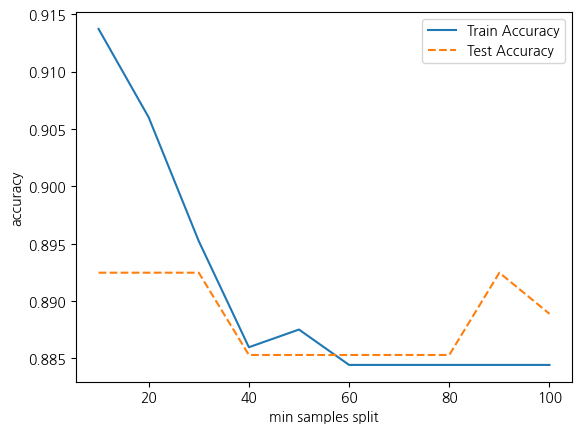

In [95]:

plt.plot(para_split, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_split, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("min samples split"); plt.ylabel("accuracy")
plt.legend()

min samples split 20개일 때 test 정확도가 가장 높아서 20개로 선정하였다.

In [96]:
# min_samples_leaf: 최적값 설정

train_accuracy = []; test_accuracy = []
para_leaf = [n_leaf * 5 for n_leaf in range(1, 11)]

for v_min_samples_leaf in para_leaf:
    rf = RandomForestClassifier(min_samples_leaf = v_min_samples_leaf, min_samples_split = 20 ,
                                max_depth=6, n_estimators=90, random_state=10)
    rf.fit(df_train_x, df_train_y)
    train_accuracy.append(rf.score(df_train_x, df_train_y))
    test_accuracy.append(rf.score(df_test_x, df_test_y))


df_accuracy_leaf = pd.DataFrame()
df_accuracy_leaf["MinSamplesLeaf"] = para_leaf
df_accuracy_leaf["TrainAccuracy"] = train_accuracy
df_accuracy_leaf["TestAccuracy"] = test_accuracy

df_accuracy_leaf.round(3)

,MinSamplesLeaf,TrainAccuracy,TestAccuracy
0,5,0.901,0.889
1,10,0.894,0.889
2,15,0.858,0.853
3,20,0.818,0.839
4,25,0.797,0.832
5,30,0.797,0.832
6,35,0.797,0.832
7,40,0.797,0.832
8,45,0.797,0.832
9,50,0.797,0.832


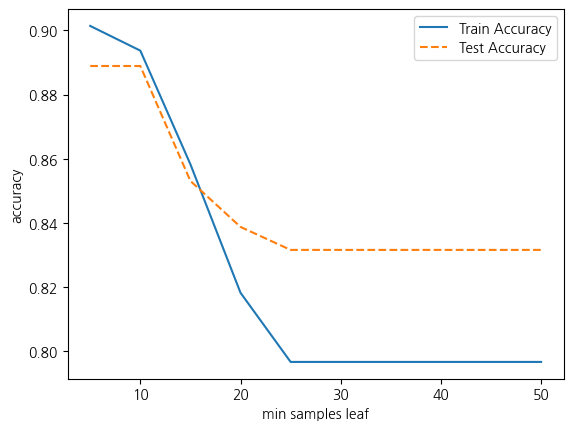

In [97]:
plt.plot(para_leaf, train_accuracy, linestyle = "-", label = "Train Accuracy")
plt.plot(para_leaf, test_accuracy, linestyle = "--", label = "Test Accuracy")
plt.xlabel("min samples leaf"); plt.ylabel("accuracy")
plt.legend()

min samples leaf = 5 일때 가장 높은 정확도를 보이고 있으므로 최적값을 5로 선정하였다.

### 최종모델

In [100]:
# 최종 모델
rf_final = RandomForestClassifier(min_samples_leaf=5, max_depth=6, n_estimators=90,
                                 min_samples_split = 20 ,random_state=10)
rf_final.fit(df_train_x, df_train_y)

y_pred = rf_final.predict(df_test_x)


print("Accuracy on training set: {:.3f}".format(rf_final.score(df_train_x, df_train_y)))
print("Accuracy on test set: {:.3f}\n".format(rf_final.score(df_test_x, df_test_y)))
print("Confusion matrix: \n{}".format(confusion_matrix(df_test_y, y_pred)))
print(classification_report(df_test_y, y_pred, digits=3))

Accuracy on training set: 0.901
Accuracy on test set: 0.889

Confusion matrix: 
[[229   3]
 [ 28  19]]
              precision    recall  f1-score   support

           0      0.891     0.987     0.937       232
           1      0.864     0.404     0.551        47

    accuracy                          0.889       279
   macro avg      0.877     0.696     0.744       279
weighted avg      0.886     0.889     0.872       279



1에 대한 recall score 가 낮은것을 확인할 수 있다.

In [101]:
# 변수명
v_feature_names = df_train_x.columns
df_importance = pd.DataFrame()
df_importance ["Feature"] = v_feature_names
df_importance ["Importance"] = rf_final.feature_importances_
df_importance .sort_values("Importance", ascending=False, inplace = True)
df_importance .round(3)

,Feature,Importance
17,HANDSET_ASAD90,0.259
2,DROPPED_CALLS,0.181
20,HANDSET_CAS30,0.092
4,PEAK_CALLS_TIME,0.065
8,TOTAL_CALLS_TIME,0.056
7,TOTAL_CALLS_NO,0.036
0,AGE,0.035
1,SERVICE_DURATION,0.028
26,HANDSET_WC95,0.027
25,HANDSET_SOP20,0.027


Text(0, 0.5, '설명변수')

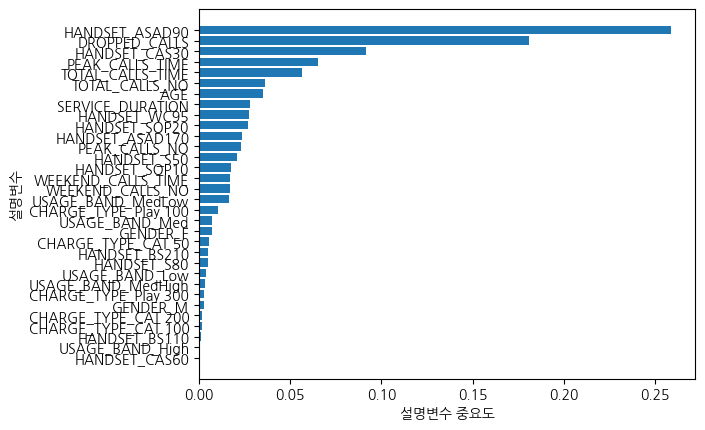

In [102]:

df_importance .sort_values("Importance", ascending=True, inplace = True)
coordinates = range(len(df_importance ))
plt.barh(y = coordinates, width = df_importance ["Importance"])
plt.yticks(coordinates, df_importance ["Feature"])
plt.xlabel("설명변수 중요도")
plt.ylabel("설명변수")

HANDSET , DROPPED_CALL , PEAK_CALLS_TIME 순으로 중요도가 높은 것을 확인 할 수 있다. <BR>
고객이탈을 막기 위해 새로운 기종에 대한 할인혜택을 제공하는 방안이 있을 수 있다. <BR>
PEAK_CALLS_TIME 중요도가 높기에 이탈을 막기위한 방안으로 무제한 통화사용을 제공할 수도 있다.